<a href="https://colab.research.google.com/github/azmd801/back_order_prediction/blob/main/notebook/eda.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Problem Statement:
Backorders are unavoidable, but by anticipating which things will be backordered,
planning can be streamlined at several levels, preventing unexpected strain on
production, logistics, and transportation. ERP systems generate a lot of data (mainly
structured) and also contain a lot of historical data; if this data can be properly utilized, a
predictive model to forecast backorders and plan accordingly can be constructed.
Based on past data from inventories, supply chain, and sales, classify the products as
going into backorder (Yes or No).

## Dataset Description

This dataset contains information about inventory levels and sales of products. It has 23 features including the SKU (Stock Keeping Unit) of the product, inventory levels, lead time, forecasted sales, actual sales, and various risk factors associated with the product. The dataset also includes a binary target variable indicating whether the product went on backorder or not.

## Features Description

- `sku`: The unique identifier for each product.
- `national_inv`: The current inventory level of the product in the national warehouse.
- `lead_time`: The number of weeks it takes to receive the product from the supplier.
- `in_transit_qty`: The quantity of the product currently in transit from the supplier.
- `forecast_3_month`: The forecasted sales for the product over the next 3 months.
- `forecast_6_month`: The forecasted sales for the product over the next 6 months.
- `forecast_9_month`: The forecasted sales for the product over the next 9 months.
- `sales_1_month`: The actual sales of the product in the last month.
- `sales_3_month`: The actual sales of the product in the last 3 months.
- `sales_6_month`: The actual sales of the product in the last 6 months.
- `sales_9_month`: The actual sales of the product in the last 9 months.
- `min_bank`: The minimum amount of inventory needed to avoid a stockout.
- `potential_issue`: Indicates if the product has a potential issue that could cause a stockout.
- `pieces_past_due`: The number of pieces of the product that are past due.
- `perf_6_month_avg`: The average performance score of the product over the last 6 months.
- `perf_12_month_avg`: The average performance score of the product over the last 12 months.
- `local_bo_qty`: The quantity of the product currently on backorder at the local warehouse.
- `deck_risk`: Indicates if the product is at risk of being damaged during shipping.
- `oe_constraint`: Indicates if there are any OE (Original Equipment) constraints on the product.
- `ppap_risk`: Indicates if the product is at risk of not meeting PPAP (Production Part Approval Process) requirements.
- `stop_auto_buy`: Indicates if the product is set to automatically be reordered when inventory levels reach a certain threshold.
- `rev_stop`: Indicates if the product is revenue stopped.
- `went_on_backorder`: The binary target variable indicating whether the product went on backorder or not.

# Summary

##  Dataset Overview:
- Number of variables: 23
- Number of observations: 1,687,861
- Missing cells: 100,915 (0.3%)
- Duplicate rows: 0
- Total size in memory: 296.2 MiB
- Average record size in memory: 184.0 B



### Summary of Numeric columns

* `national_inv`: 1 missing value, have negative values, skewed distribution check for outliers and avoid mean imputaion
* `lead_time`: 100894 missing values(6 %) , check for outliers
* `in_transit_qty` : 1 missing value, skewed,check for outliers,very sparse columns
* `forecast_3_month`: 1 missing value, skewed,sparse
* `forecast_6_month`: 1 missing value, skewed,sparse(65% zeros)
* `forecast_9_month`: 1 missing value, skewed,sparse(61.2% zeros)
* `sale_1_month`: 1 missing value, skewed,sparse(56.9% zeros)
* `sale_3_month`: 1 missing value, skewed,sparse(45.2% zeros)
* `sale_6_month`: 1 missing value, skewed,sparse(38.3% zeros)
* `sale_9_month`: 1 missing value, skewed,sparse(34.7% zeros)
* `min_bank`: 1 missing value, skewed,sparse(51.7% zeros)
* `pieces_past_due`: 1 missing value, sparse(98.5 %)
* `perf_6_month_avg`: 1 missing value, contains only one negativve value -99 (7.7% ) could be errornous
* `perf_12_month_avg`: 1 missing value, contains only one negativve value -99 (7.2% ) could be errornous
* `local_bo_qty`:1 missing value, skewed,sparse(98.6% zeros)

### Summary of Catgorical columns

* `potential_issue` (boolean): 1 missing value,estremly imbalanced(99.9% false)
* `deck_risk` (boolean): 1 missing value,slighltly imbalanced(77% false)
* `oe_constraints` (boolean): 1 missing value,extremly imbalanced(99.9% False)
* `ppap_risk`(boolean): 1 missing value,highly imbalanced(87.9% False)
* `stop_auto_buy` (boolean): 1 missing value,highly imbalanced(96.4% true)
* `rev_stop` (boolean): 1 missing value,estremly imbalanced(99.9% false)

### Summary of target columns

* `went_on_backorder`:  1 missing value,estremly imbalanced(99.3% false)

## Further Exploration of Features

### Using Raw Data
- All numeric features contain a lot of outliers
- KDE plot with outliers shows limited information
- Power transformation does not remove skewness effectively
- Revisit KDE plots after handling outliers using winsorization technique

### Using Data with Outlier Capping
- After capping ouliers some extreme sparse features were showing no distribution so it will be dropped
- Those features are `'in_transit_qty'`, `'local_bo_qty'`, `'pieces_past_due'`
- Univariate analysis shows modified features have good predictive capabilities
- Power transform is not recommended for handling outliers

## EDA on Balanced Data Set
- Dataset with outlier capped and extreme sparse features dropped will be used
- Dataset is balanced and EDA is performed again

### Using Random Oversampling
- After upscaling winsorized numeric features, they show good discriminating behavior
- Features `'potential_issue'`, `'oe_constraint'`, and `'rev_stop'` show no discriminating behavior and may be dropped for further analysis
- Other categorical features show good discriminating behavior

### EDA on Balanced Data Set Using SMOTE
- Results are similar to random oversampling

# Loading the data

In [1]:
# intalling required libraries
!pip install unrar
!pip install patool

import os
import patoolib

# Create a directory to store the dataset
if not os.path.exists("dataset"):
    os.makedirs("dataset")

# Download the RAR file from GitHub
!wget -O dataset/dataset.rar https://github.com/rodrigosantis1/backorder_prediction/raw/master/dataset.rar

# Extract the RAR file
patoolib.extract_archive("dataset/dataset.rar", outdir="dataset")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.5/77.5 kB 1.9 MB/s eta 0:00:00
--2023-07-19 17:33:43--  https://github.com/rodrigosantis1/backorder_prediction/raw/master/dataset.rar
Resolving github.com (github.com)... 192.30.255.113
Connecting to github.com (github.com)|192.30.255.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rodrigosantis1/backorder_prediction/master/dataset.rar [following]
--2023-07-19 17:33:43--  https://raw.githubusercontent.com/rodrigosantis1/backorder_prediction/master/dataset.rar
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 24741696 (24M) [application/octet-stream]
Saving to: ‘dataset/dataset.rar’

dataset/dataset.rar 100%[===================>]  23.59M  --.-KB

'dataset'

# Important functions to perform EDA

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import math
from scipy.stats import yeojohnson

def plot_univariate_analysis(data, feature_cols, plot_type, target=None, hue=None,box_cox=False, figsize=(12, 8)):
    """
    Plot univariate features of a DataFrame using the specified plot type.

    Parameters:
    - df (pd.DataFrame): Input DataFrame.
    - feature_cols (list): List of feature columns to plot.
    - plot_type (str): Type of plot to generate ('box', 'count', or 'kde').
    - target (str): Name of the target variable (optional, required for 'box' plot).
    - hue (str): Name of the variable to use for coloring the plot (optional).
    - figsize (tuple): Figure size (default: (12, 8)).

    Returns:
    - None
    """
    num_features = len(feature_cols)
    # cols = math.ceil(math.sqrt(num_features))
    cols = 3
    rows = math.ceil(num_features / cols)

    fig, axes = plt.subplots(rows, cols, figsize=figsize)
    fig.suptitle(f"{plot_type.capitalize()} Plots of Features", fontsize=16)
    axes = axes.flatten()

    df = data.copy()

    if box_cox:
      df[feature_cols] = df[feature_cols].apply(lambda x: yeojohnson(x)[0],axis=1,result_type='broadcast')
      df.dropna(inplace=True)
      # return df

    for i, feature in enumerate(feature_cols):
        ax = axes[i]

        if plot_type == 'box':
              if hue:
                  sns.boxplot(data=df, y=feature, x=hue, ax=ax)
              else:
                  sns.boxplot(data=df, y=feature, ax=ax)

        elif plot_type == 'count':
            if hue:
                sns.countplot(x=feature, hue=hue, data=df, ax=ax)
            else:
                sns.countplot(x=feature, data=df, ax=ax)

        elif plot_type == 'kde':
            if hue:
                sns.kdeplot(data=df, x=feature, hue=hue, ax=ax,common_norm=False)
            else:
                sns.kdeplot(data=df, x=feature, ax=ax)

        ax.set_title(f"{plot_type.capitalize()} Plot: {feature}", fontsize=12)
        ax.set_xlabel(feature)
        ax.set_ylabel("Count")

    # Remove any empty subplots
    if len(feature_cols) < rows * cols:
        for j in range(len(feature_cols), rows * cols):
            fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

In [3]:
import numpy as np

def winsorize(column: np.ndarray) -> np.ndarray:
    """
    Winsorize a numeric column by capping values at the lower and upper bounds.

    Parameters:
        column (numpy.ndarray): The numeric column to be winsorized.

    Returns:
        numpy.ndarray: The winsorized column with capped values.
    """
    # Calculate the percentiles
    p0 = np.nanpercentile(column, 0)
    p100 = np.nanpercentile(column, 100)

    # Calculate the lower and upper IQR
    Q1 = np.nanpercentile(column, 25)
    Q3 = np.nanpercentile(column, 75)
    IQR = Q3 - Q1

    # Calculate the lower and upper bounds
    LL = max(Q1 - (1.5 * IQR),p0)
    UL = min(Q3 + (1.5 * IQR),p100)

    # Apply winsorization
    winsorized_column = np.where(column < LL, LL, np.where(column > UL, UL, column))

    return winsorized_column

# EDA Starts here

## EDA of raw data

In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")


In [5]:
# reading th data
raw_data = pd.read_csv(r"/content/dataset/Kaggle_Training_Dataset_v2.csv")
raw_data.shape

(1687861, 23)

In [ ]:
raw_data

,sku,national_inv,lead_time,in_transit_qty,forecast_3_month,forecast_6_month,forecast_9_month,sales_1_month,sales_3_month,sales_6_month,...,pieces_past_due,perf_6_month_avg,perf_12_month_avg,local_bo_qty,deck_risk,oe_constraint,ppap_risk,stop_auto_buy,rev_stop,went_on_backorder
0,1026827,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-99.00,-99.00,0.0,No,No,No,Yes,No,No
1,1043384,2.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.99,0.99,0.0,No,No,No,Yes,No,No
2,1043696,2.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-99.00,-99.00,0.0,Yes,No,No,Yes,No,No
3,1043852,7.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.10,0.13,0.0,No,No,No,Yes,No,No
4,1044048,8.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-99.00,-99.00,0.0,Yes,No,No,Yes,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1687856,1373987,-1.0,NaN,0.0,5.0,7.0,9.0,1.0,3.0,3.0,...,0.0,-99.00,-99.00,1.0,No,No,No,Yes,No,No
1687857,1524346,-1.0,9.0,0.0,7.0,9.0,11.0,0.0,8.0,11.0,...,0.0,0.86,0.84,1.0,Yes,No,No,No,No,Yes
1687858,1439563,62.0,9.0,16.0,39.0,87.0,126.0,35.0,63.0,153.0,...,0.0,0.86,0.84,6.0,No,No,No,Yes,No,No
1687859,1502009,19.0,4.0,0.0,0.0,0.0,0.0,2.0,7.0,12.0,...,0.0,0.73,0.78,1.0,No,No,No,Yes,No,No


### EDA using panda profiling

In [ ]:
!pip install pandas_profiling

In [ ]:
# Importing necessary libraries
import pandas as pd
import pandas_profiling

# Generating the report using pandas profiling
profile = pandas_profiling.ProfileReport(raw_data)

# Saving the report as HTML file
profile.to_file(output_file="output.html")



Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
from IPython.display import display, HTML

# Read the HTML report file
with open('output.html', 'r') as f:
    html_content = f.read()

# Display the HTML report
display(HTML(html_content))

Number of variables,23
Number of observations,1687861
Missing cells,100915
Missing cells (%),0.3%
Duplicate rows,168735
Duplicate rows (%),10.0%
Total size in memory,296.2 MiB
Average record size in memory,184.0 B
Unsupported,1
Numeric,15
Boolean,7


In [ ]:
# Count the number of duplicate rows
num_duplicates = raw_data.duplicated().sum()
print(f'Number of duplicated rows: {num_duplicates}')

Number of duplicated rows: 0


* No data point is repeated

### Summary of Pandas Profiling

#### Basic summary of dataset

* Number of variables	23
* Number of observations	1687861
* Missing cells	100915 (0.3%)
* Duplicate rows	0
* Total size in memory	296.2 MiB
* Average record size in memory	184.0 B

#### summary of Numeric columns

* national_inv: 1 missing value, have negative values, skewed distribution check for outliers and avoid mean imputaion
* lead_time: 100894 missing values(6 %) , check for outliers
* in_transit_qty : 1 missing value, skewed,check for outliers,very sparse columns
* forecast_3_month: 1 missing value, skewed,sparse
* forecast_6_month: 1 missing value, skewed,sparse(65% zeros)
* forecast_9_month: 1 missing value, skewed,sparse(61.2% zeros)
* sale_1_month: 1 missing value, skewed,sparse(56.9% zeros)
* sale_3_month: 1 missing value, skewed,sparse(45.2% zeros)
* sale_6_month: 1 missing value, skewed,sparse(38.3% zeros)
* sale_9_month: 1 missing value, skewed,sparse(34.7% zeros)
* min_bank: 1 missing value, skewed,sparse(51.7% zeros)
* pieces_past_due: 1 missing value, sparse(98.5 %)
* perf_6_month_avg: 1 missing value, contains only one negativve value -99 (7.7% ) could be errornous
* perf_12_month_avg: 1 missing value, contains only one negativve value -99 (7.2% ) could be errornous
* local_bo_qty:1 missing value, skewed,sparse(98.6% zeros)

#### summary of Catgorical columns

* potential_issue (boolean): 1 missing value,estremly imbalanced(99.9% false)
* deck_risk (boolean): 1 missing value,slighltly imbalanced(77% false)
* oe_constraints (boolean): 1 missing value,extremly imbalanced(99.9% False)
* ppap_risk(boolean): 1 missing value,highly imbalanced(87.9% False)
* stop_auto_buy (boolean): 1 missing value,highly imbalanced(96.4% true)
* rev_stop (boolean): 1 missing value,estremly imbalanced(99.9% false)

#### summary of target columns

went_on_backorder:  1 missing value,estremly imbalanced(99.3% false)

### Missing value analysis

 * lead_time has 100894 missing records (6%) which is large so these records cant be dropped
 * For rest of the features there is onlu one missing records so these will be dropped

In [9]:
# Observing lead_time
raw_data[raw_data['lead_time'].isna()]

,sku,national_inv,lead_time,in_transit_qty,forecast_3_month,forecast_6_month,forecast_9_month,sales_1_month,sales_3_month,sales_6_month,...,pieces_past_due,perf_6_month_avg,perf_12_month_avg,local_bo_qty,deck_risk,oe_constraint,ppap_risk,stop_auto_buy,rev_stop,went_on_backorder
0,1026827,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-99.0,-99.0,0.0,No,No,No,Yes,No,No
2,1043696,2.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-99.0,-99.0,0.0,Yes,No,No,Yes,No,No
4,1044048,8.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-99.0,-99.0,0.0,Yes,No,No,Yes,No,No
6,1044643,1095.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-99.0,-99.0,0.0,Yes,No,No,Yes,No,No
8,1045815,140.0,NaN,0.0,15.0,114.0,152.0,0.0,0.0,0.0,...,0.0,-99.0,-99.0,0.0,No,No,No,Yes,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1687835,1588495,227.0,NaN,8.0,0.0,0.0,0.0,19.0,78.0,205.0,...,0.0,-99.0,-99.0,1.0,No,No,Yes,No,No,No
1687847,1375861,-206.0,NaN,0.0,760.0,1145.0,1453.0,114.0,853.0,1764.0,...,0.0,-99.0,-99.0,206.0,Yes,No,No,Yes,No,No
1687850,1446671,-2.0,NaN,0.0,0.0,62.0,86.0,6.0,32.0,46.0,...,0.0,-99.0,-99.0,32.0,Yes,No,No,No,No,No
1687856,1373987,-1.0,NaN,0.0,5.0,7.0,9.0,1.0,3.0,3.0,...,0.0,-99.0,-99.0,1.0,No,No,No,Yes,No,No


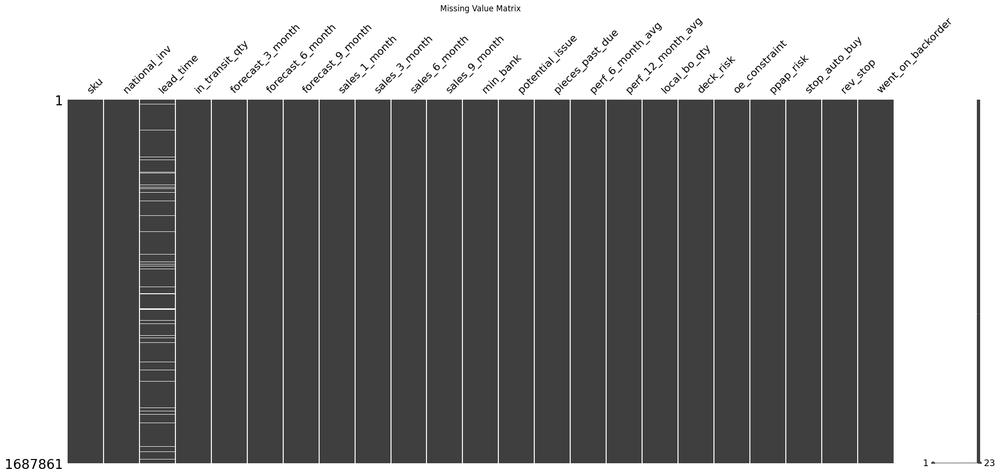

In [10]:
import missingno as msno
import matplotlib.pyplot as plt

# graphical representation of missingvalue in matrix
msno.matrix(raw_data)
plt.title('Missing Value Matrix')
plt.show()

* From the plot we can say that missng value of lead time is completely random.

### Further analysis

#### Using Raw data

In [ ]:
raw_data.dtypes

sku                   object
national_inv         float64
lead_time            float64
in_transit_qty       float64
forecast_3_month     float64
forecast_6_month     float64
forecast_9_month     float64
sales_1_month        float64
sales_3_month        float64
sales_6_month        float64
sales_9_month        float64
min_bank             float64
potential_issue       object
pieces_past_due      float64
perf_6_month_avg     float64
perf_12_month_avg    float64
local_bo_qty         float64
deck_risk             object
oe_constraint         object
ppap_risk             object
stop_auto_buy         object
rev_stop              object
went_on_backorder     object
dtype: object

In [ ]:
# segregating numeric and categorical fetaure
numeric_cols = raw_data.columns[raw_data.dtypes != 'object']
print(f'Numeric columns: {numeric_cols}')

cat_cols = raw_data.columns[raw_data.dtypes == 'object']
print(f'Categorical columns: {cat_cols}\n')

print(f'Target columns = went_on_backorder')

Numeric columns: Index(['national_inv', 'lead_time', 'in_transit_qty', 'forecast_3_month',
       'forecast_6_month', 'forecast_9_month', 'sales_1_month',
       'sales_3_month', 'sales_6_month', 'sales_9_month', 'min_bank',
       'pieces_past_due', 'perf_6_month_avg', 'perf_12_month_avg',
       'local_bo_qty'],
      dtype='object')
Categorical columns: Index(['sku', 'potential_issue', 'deck_risk', 'oe_constraint', 'ppap_risk',
       'stop_auto_buy', 'rev_stop', 'went_on_backorder'],
      dtype='object')

Target columns = went_on_backorder


In [ ]:
cat_cols.values

array(['sku', 'potential_issue', 'deck_risk', 'oe_constraint',
       'ppap_risk', 'stop_auto_buy', 'rev_stop', 'went_on_backorder'],
      dtype=object)

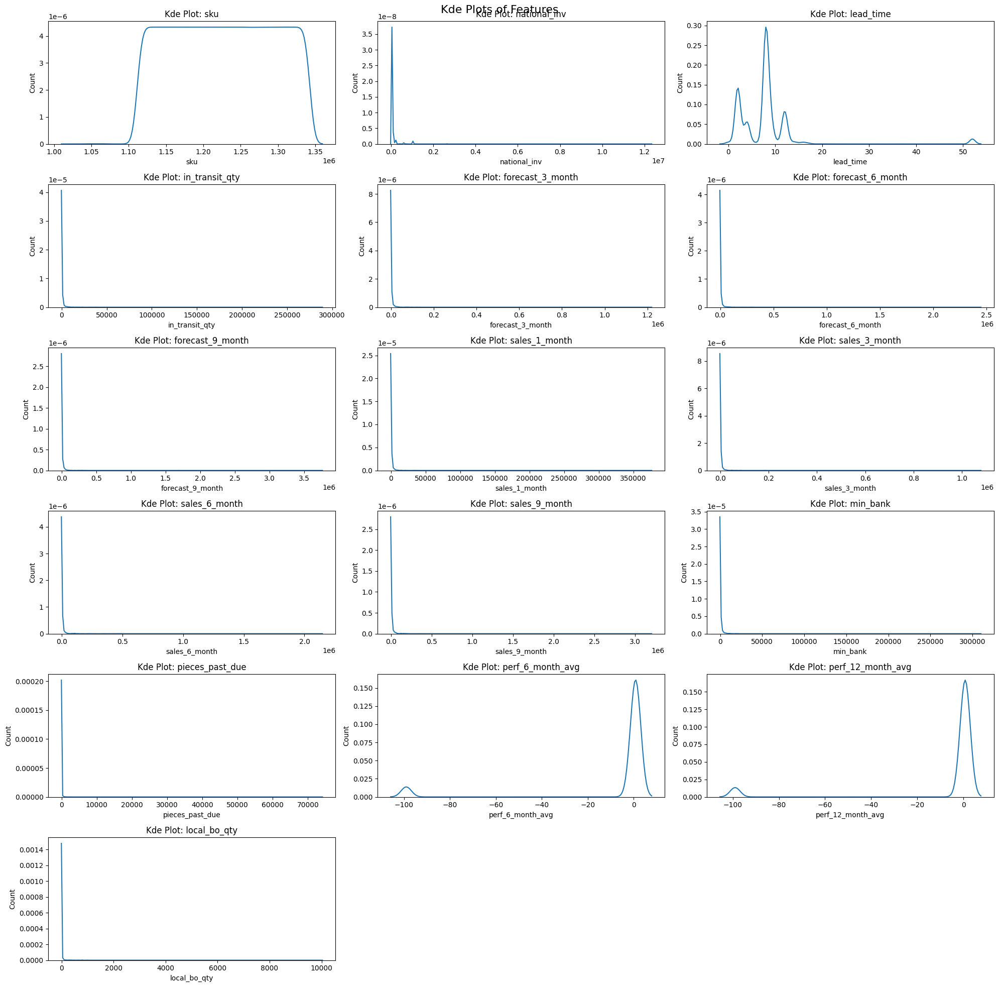

In [ ]:
# kde plot for for all numeric features without any modification
plot_univariate_analysis(data=raw_data, feature_cols=numeric_cols, plot_type='kde', target=None, hue=None,box_cox=False, figsize=(20,20))

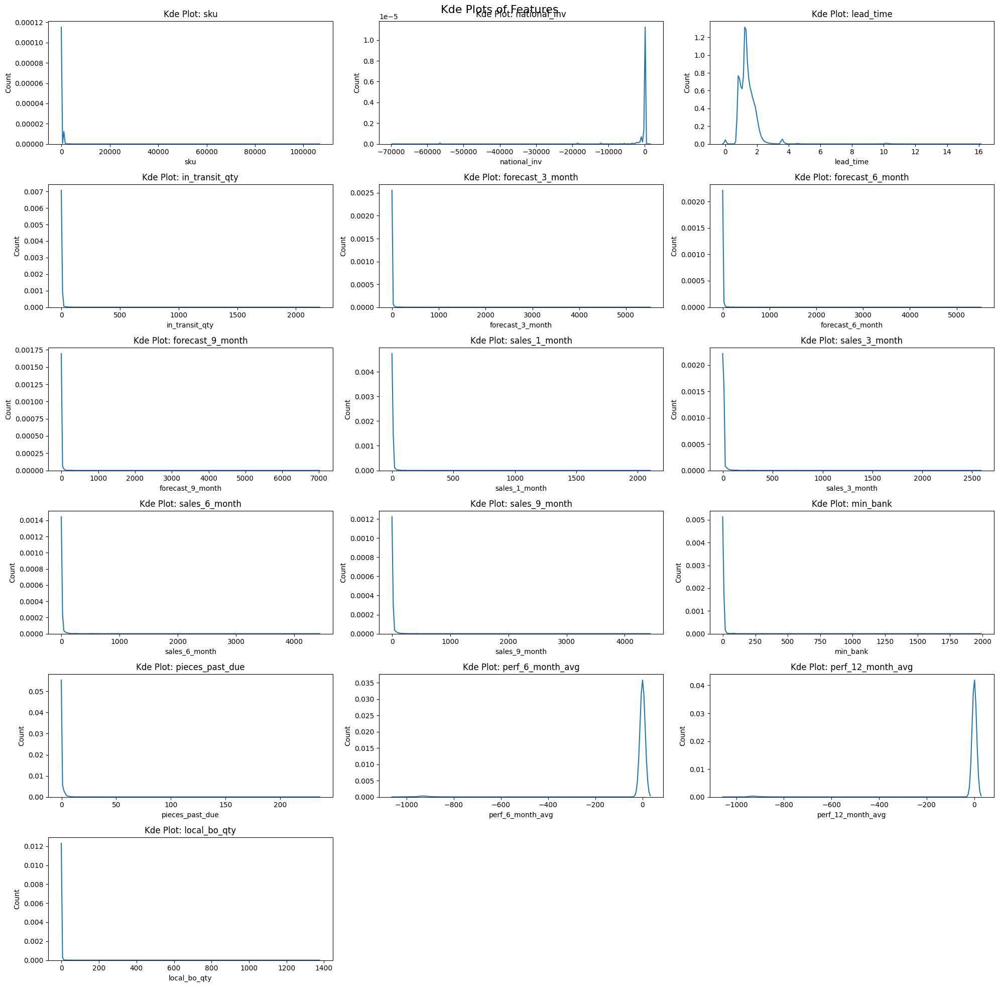

In [ ]:
# kde plot for for all numeric features with a power transform
plot_univariate_analysis(data=raw_data, feature_cols=numeric_cols, plot_type='kde', target=None, hue=None,box_cox=True, figsize=(20,20))

* All numeric features contains lot of outliers
* kde plot in the presence of outliers is not showing much information
* Power transformation is doing any help in removing skewness of the data
* kde plots need to plotted again after handiling ouliers usinf winsorization technique

In [ ]:
from prettytable import PrettyTable

# Create a PrettyTable instance
table = PrettyTable()
table.field_names = ['Feature', 'Lower IQR', '0%', '5%', '95%', '99%', '100%', 'Upper IQR']

# Iterate over each numeric column
for column in numeric_cols:
    # Calculate the IQR
    Q1 = raw_data[column].quantile(0.25)
    Q3 = raw_data[column].quantile(0.75)
    IQR = Q3 - Q1

    # Calculate the percentiles
    percentiles = raw_data[column].describe(percentiles=[0, 0.05, 0.95, 0.99, 1]).loc[['0%', '5%', '95%', '99%', '100%']]

    # Add a row to the PrettyTable
    table.add_row([column, Q1 - (1.5 * IQR), percentiles['0%'], percentiles['5%'], percentiles['95%'], percentiles['99%'], percentiles['100%'], Q3 + (1.5 * IQR)])

# Print the table
print(table)

+-------------------+---------------------+-----------+------------+--------------------+--------------------+------------+--------------------+
|      Feature      |      Lower IQR      |     0%    |     5%     |        95%         |        99%         |    100%    |     Upper IQR      |
+-------------------+---------------------+-----------+------------+--------------------+--------------------+------------+--------------------+
|        sku        |      1082649.5      | 1026827.0 | 1114405.95 |     1166371.05     |     1168680.61     | 1237426.0  |     1198127.5      |
|    national_inv   |        -111.5       |  -1302.0  |    0.0     |       899.0        | 5676.880000000005  | 12334404.0 |       196.5        |
|     lead_time     |         -3.5        |    0.0    |    2.0     |        12.0        |        52.0        |    52.0    |        16.5        |
|   in_transit_qty  |         0.0         |    0.0    |    0.0     |        66.0        | 527.6100000000006  |  217729.0  |       

#### Using data with outlier caping

In [ ]:
# caping the outlier
data = raw_data.copy(deep=True)
data[numeric_cols] = data[numeric_cols].apply(winsorize)

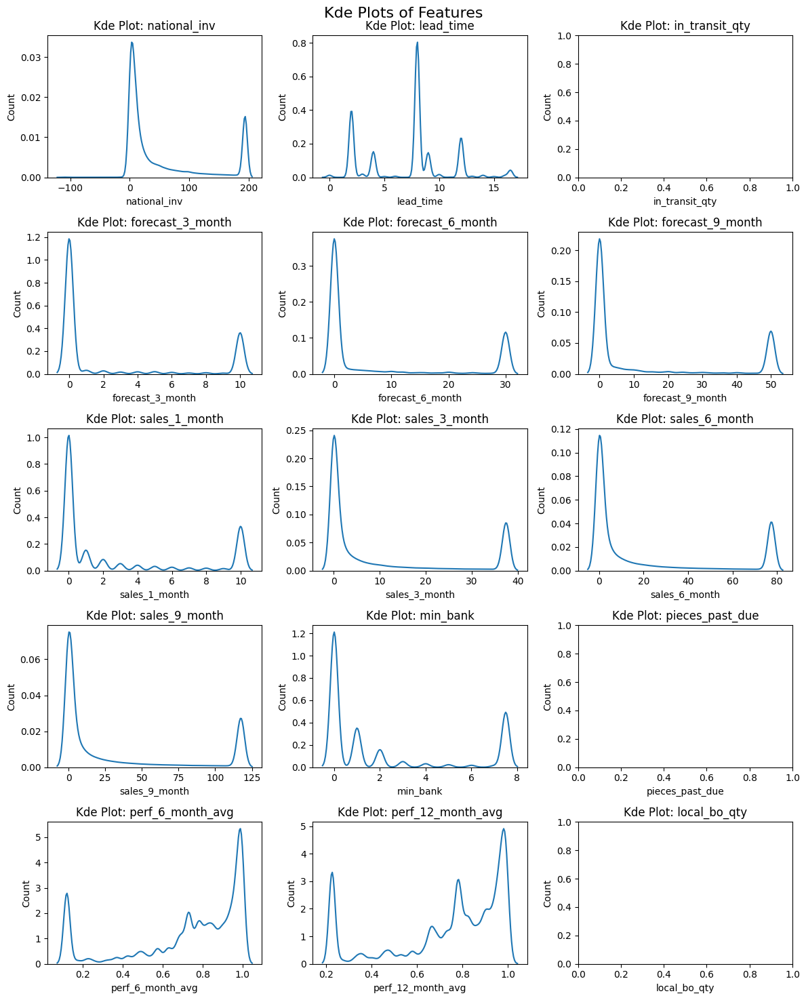

In [ ]:
# plotting after dealing with outlier
plot_univariate_analysis(data=data, feature_cols=numeric_cols, plot_type='kde', target=None, hue=None,box_cox=False, figsize=(12,15))

* After dealing with ouliers some extreme sparse features were showing no distribution so it will be dropped
* Those features are [ 'in_transit_qty', 'local_bo_qty', 'pieces_past_due' ]

#### Using data with outlier caping and removing extrem sparse features

In [ ]:
# getting non sparse numeric columns

sparse_cols = ['in_transit_qty','local_bo_qty','pieces_past_due']
req_cols = list(set(numeric_cols) - set(sparse_cols))

print(f"Non sparse columns:\n {req_cols}")

Non sparse columns:
 ['min_bank', 'sales_9_month', 'sales_6_month', 'forecast_9_month', 'lead_time', 'forecast_3_month', 'national_inv', 'perf_12_month_avg', 'sales_3_month', 'forecast_6_month', 'sales_1_month', 'perf_6_month_avg']


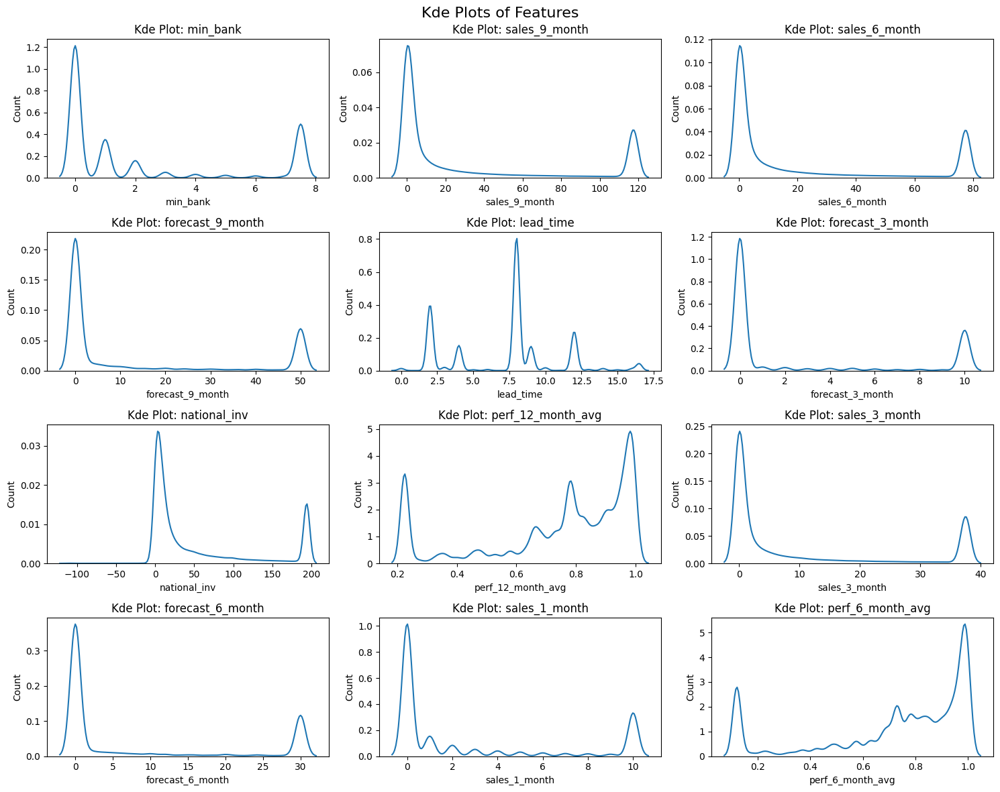

In [ ]:
# plotting after dealing with outlier and removing extreme sparse feature
plot_univariate_analysis(data=data, feature_cols=req_cols, plot_type='kde', target=None, hue=None,box_cox=False, figsize=(15,12))

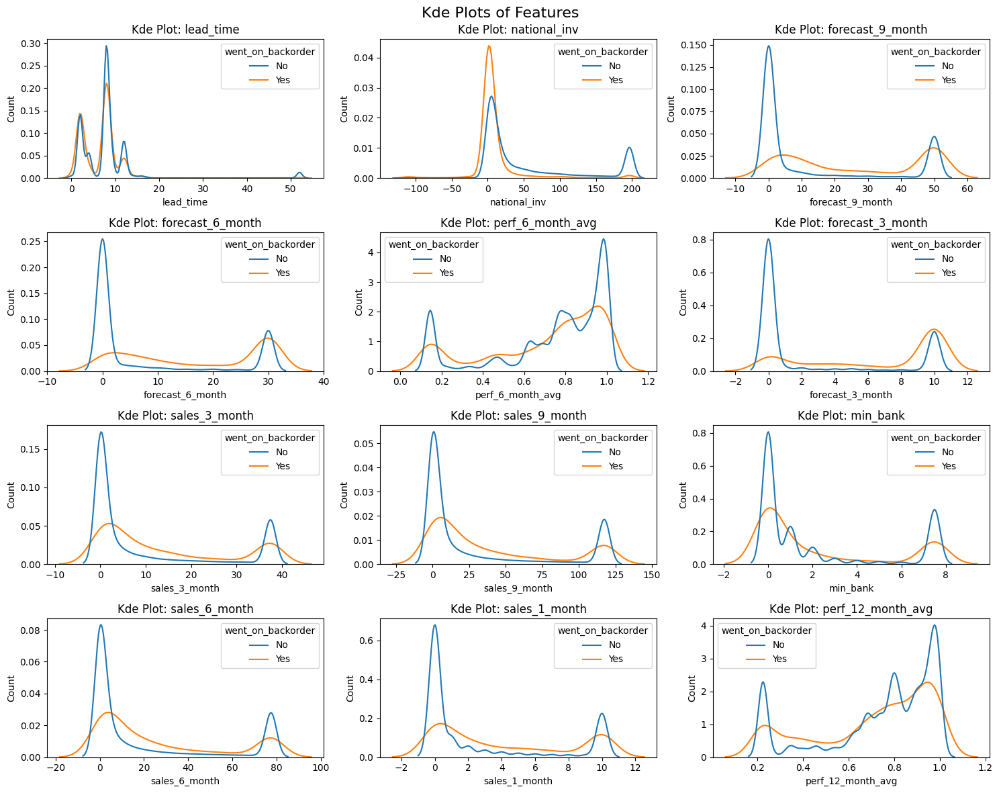

In [ ]:
#  kde plot after dealing with outlier and removing extreme sparse feature and using targe as hue
plot_univariate_analysis(data=data, feature_cols=req_cols, plot_type='kde', target=None, hue='went_on_backorder',box_cox=False, figsize=(15,12))

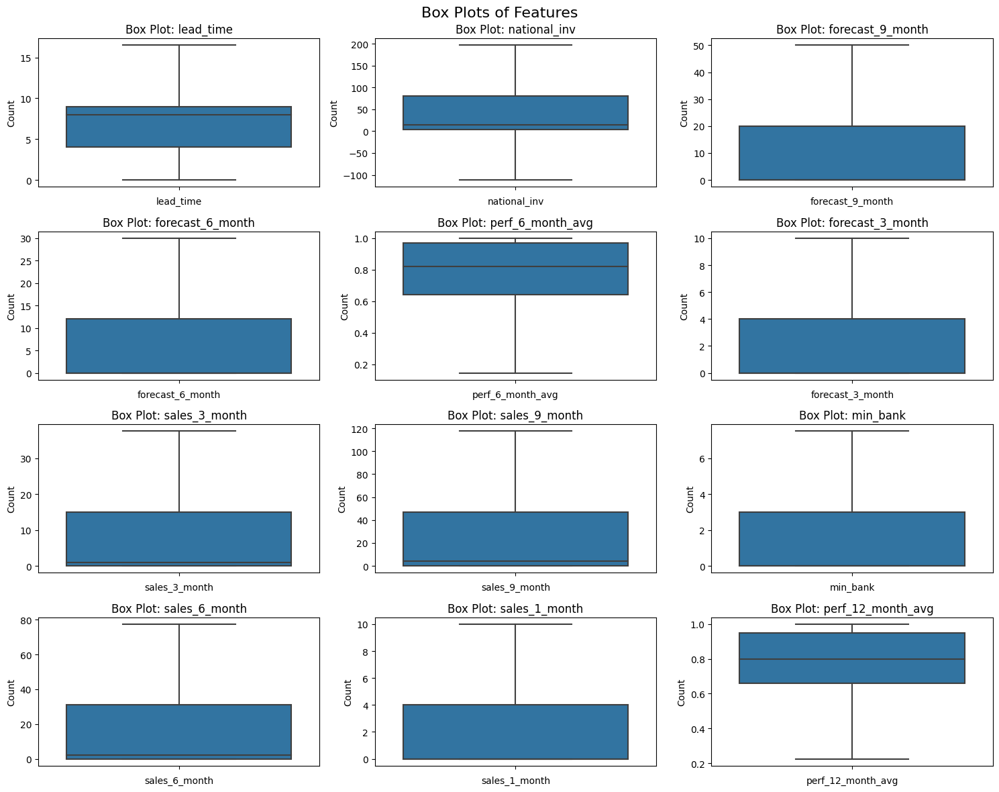

In [ ]:
# BOX plot after dealing with outlier and removing extreme sparse feature
plot_univariate_analysis(data=data, feature_cols=req_cols, plot_type='box', target=None, hue=None,box_cox=False, figsize=(15,12))

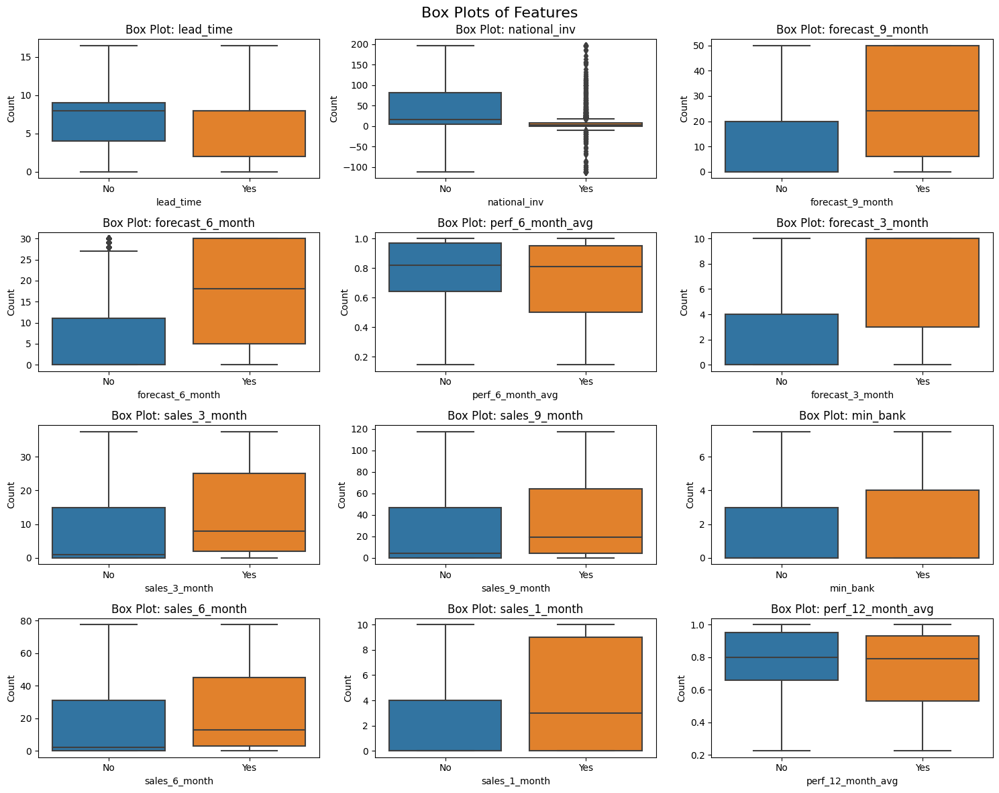

In [ ]:
#  kde plot after dealing with outlier and removing extreme sparse feature and using target as hue
plot_univariate_analysis(data=data, feature_cols=req_cols, plot_type='box', target=None, hue='went_on_backorder',box_cox=False, figsize=(15, 12))

* After capping the outlier and removing extreme sparse features , Unvariate anlayis is showing modified feature have good prodictive capablities

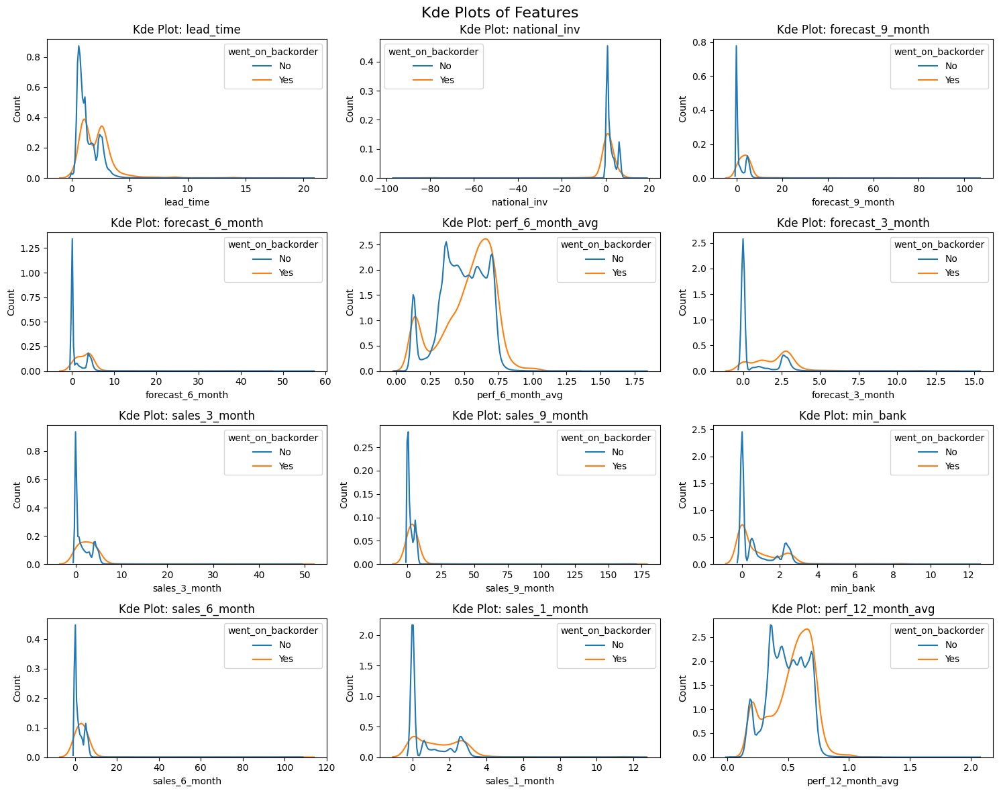

In [ ]:
#  kde plot after dealing with outlier and removing extreme sparse feature and using target as hue
plot_univariate_analysis(data=data, feature_cols=req_cols, plot_type='kde', target=None, hue='went_on_backorder',box_cox=True, figsize=(15,12))

In [ ]:
#  box plot after dealing with outlier and removing extreme sparse feature and using target as hue
# plot_univariate_analysis(data=data, feature_cols=req_cols, plot_type='box', target=None, hue='went_on_backorder',box_cox=True, figsize=(15,12))

* Power transform is doing more damage than good so it will not be used for handling ouliers

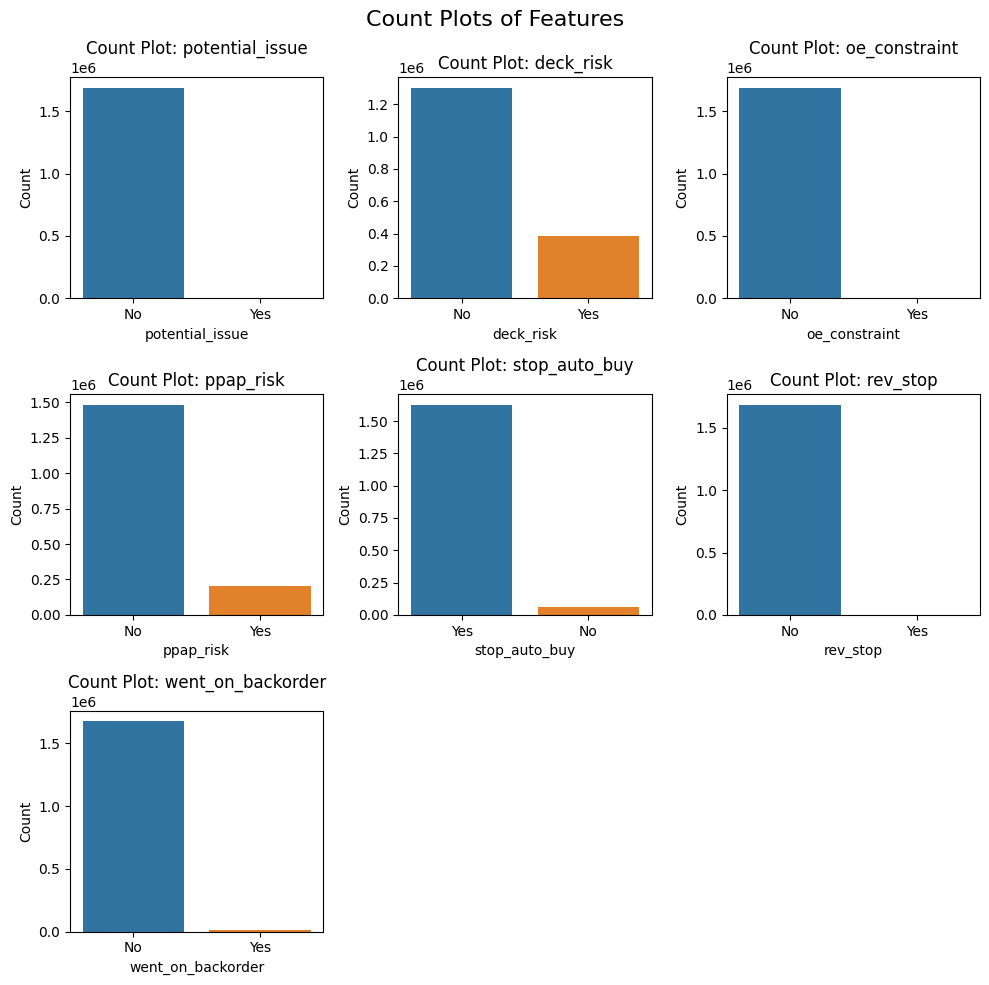

In [ ]:
plot_univariate_analysis(data=data, feature_cols=cat_cols.drop('sku'), plot_type='count', target=None,box_cox=False, figsize=(10, 10))

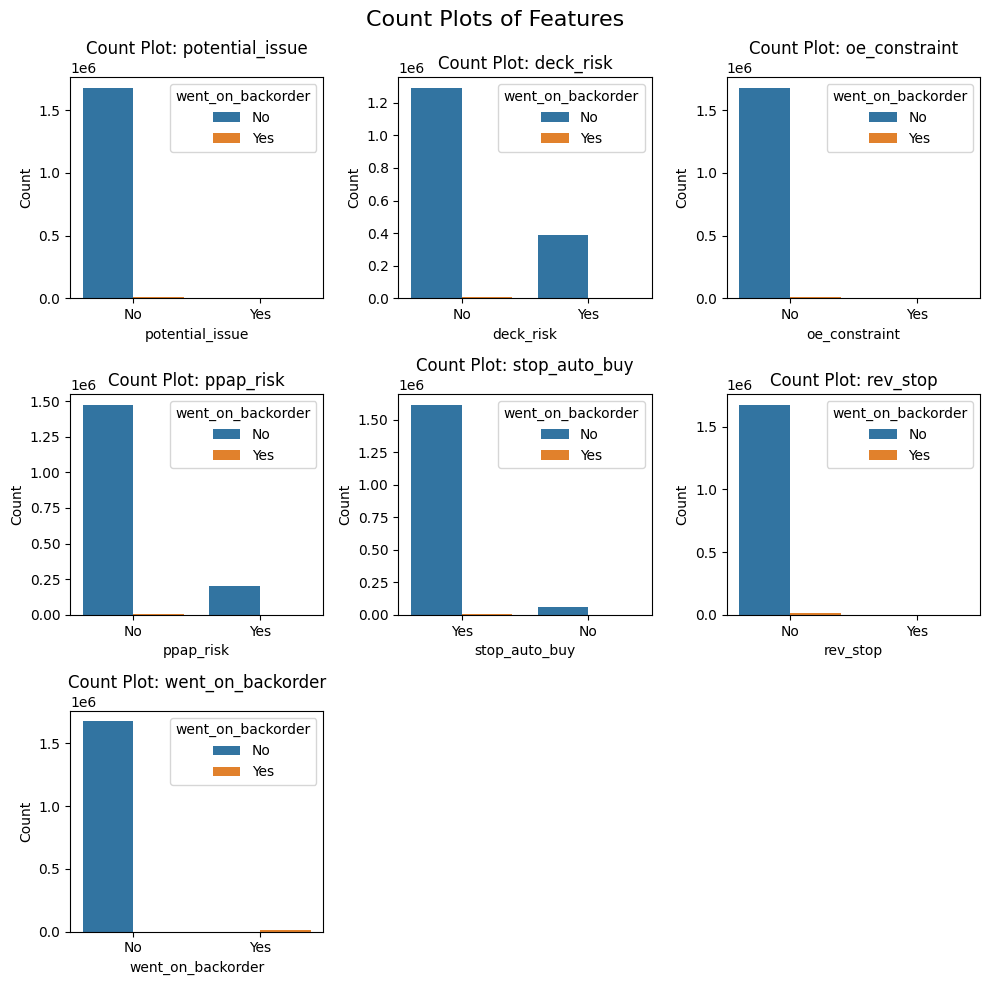

In [ ]:
plot_univariate_analysis(data=raw_data, feature_cols=cat_cols.drop('sku'), plot_type='count', target=None, hue='went_on_backorder',box_cox=False, figsize=(10, 10))

## EDA on balanced data set

* Dataset with outlier capped and extreme sparse feature dropped will be used
* Dataset is balanced and EDA is performed on it again

### Preparing data set

In [ ]:
raw_data.columns

Index(['sku', 'national_inv', 'lead_time', 'in_transit_qty',
       'forecast_3_month', 'forecast_6_month', 'forecast_9_month',
       'sales_1_month', 'sales_3_month', 'sales_6_month', 'sales_9_month',
       'min_bank', 'potential_issue', 'pieces_past_due', 'perf_6_month_avg',
       'perf_12_month_avg', 'local_bo_qty', 'deck_risk', 'oe_constraint',
       'ppap_risk', 'stop_auto_buy', 'rev_stop', 'went_on_backorder'],
      dtype='object')

In [ ]:
# reading raw data set
data=raw_data.copy(deep=True)
# dropping unnncessary columns
data = data.drop('sku',axis=1).dropna(subset=['went_on_backorder'])
# extracting target column used for upsmapling to balance
y = data['went_on_backorder'].dropna()

print(data.shape)
print(y.shape)

(1687860, 22)
(1687860,)


In [ ]:
# segregating numeric and categorical fetaure

# removing extreme sparse columns form numeric cols
sparse_cols = ['in_transit_qty','local_bo_qty','pieces_past_due']
numeric_cols = data.columns[data.dtypes != 'object'].drop(sparse_cols)
print(f'Numeric columns: {numeric_cols}\n')

cat_cols = data.columns[data.dtypes == 'object']
print(f'Categorical columns: {cat_cols}\n')

print(f"Target columns : 'went_on_backorder'")

# capping outliers
data[numeric_cols] = raw_data[numeric_cols].apply(winsorize)

Numeric columns: Index(['national_inv', 'lead_time', 'forecast_3_month', 'forecast_6_month',
       'forecast_9_month', 'sales_1_month', 'sales_3_month', 'sales_6_month',
       'sales_9_month', 'min_bank', 'perf_6_month_avg', 'perf_12_month_avg'],
      dtype='object')

Categorical columns: Index(['potential_issue', 'deck_risk', 'oe_constraint', 'ppap_risk',
       'stop_auto_buy', 'rev_stop', 'went_on_backorder'],
      dtype='object')

Target columns : 'went_on_backorder'


In [ ]:
y

0           No
1           No
2           No
3           No
4           No
          ... 
1687855     No
1687856     No
1687857    Yes
1687858     No
1687859     No
Name: went_on_backorder, Length: 1687860, dtype: object

In [ ]:
from sklearn.preprocessing import LabelEncoder
y = LabelEncoder().fit_transform(y)
y

array([0, 0, 0, ..., 1, 0, 0])

### Using random oversampling

In [ ]:
from imblearn.combine import SMOTETomek
from imblearn.over_sampling import RandomOverSampler

X,_ = RandomOverSampler().fit_resample(data,y)
# X_train,y_train = SMOTETomek().fit_resample(X_train,y_train )

print(X.shape)
print(_.shape)

(3353134, 22)
(3353134,)


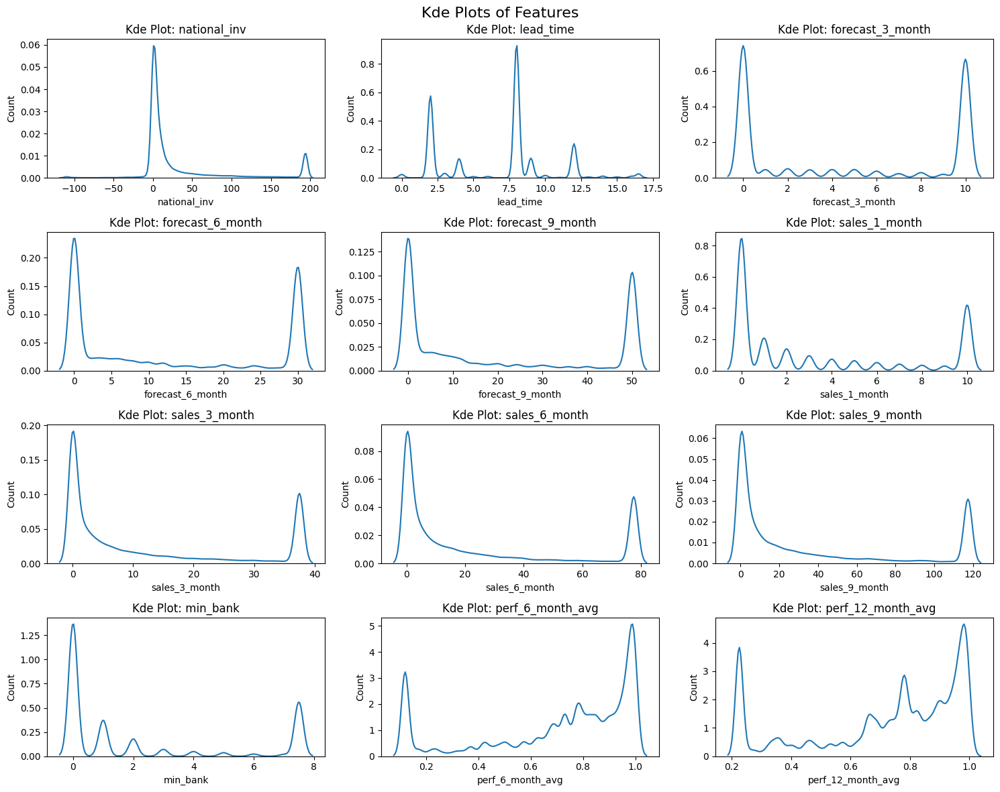

In [ ]:
# plotting after dealing with outlier and removing extreme sparse feature
plot_univariate_analysis(data=data, feature_cols=numeric_cols, plot_type='kde', target=None, hue=None,box_cox=False, figsize=(15,12))

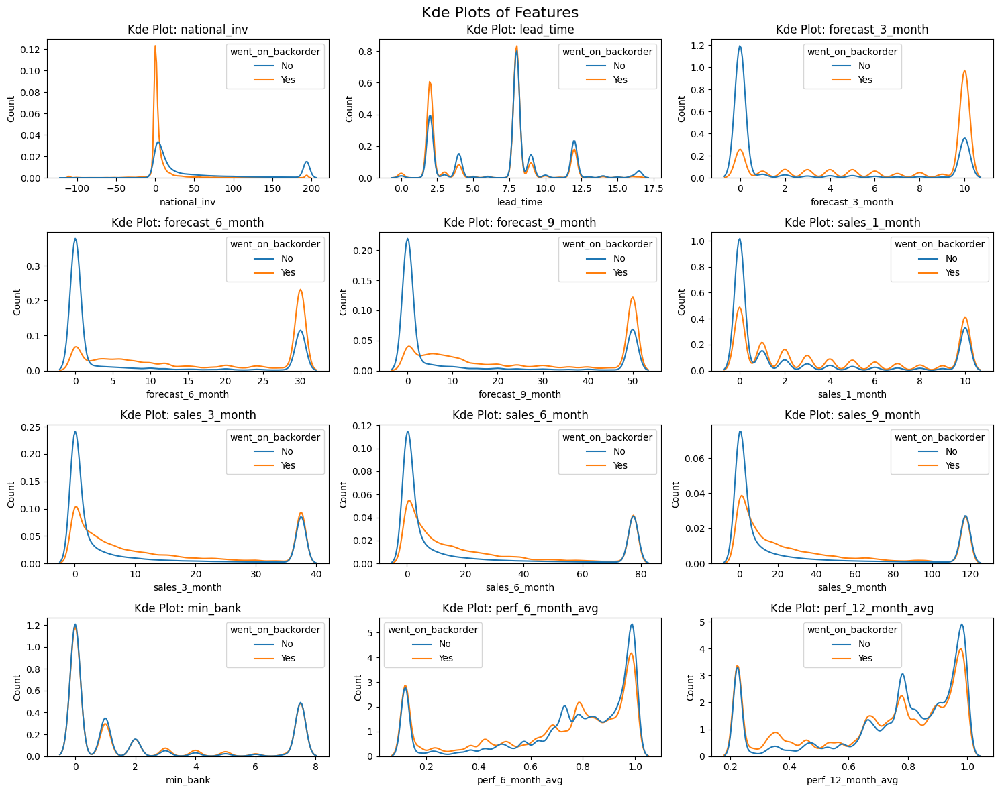

In [ ]:
# plotting after dealing with outlier and removing extreme sparse feature with hue
plot_univariate_analysis(data=X, feature_cols=numeric_cols, plot_type='kde', target=None, hue='went_on_backorder',box_cox=False, figsize=(15,12))

* After upscaling winsorized Numeric features showing good discrimainating beviour


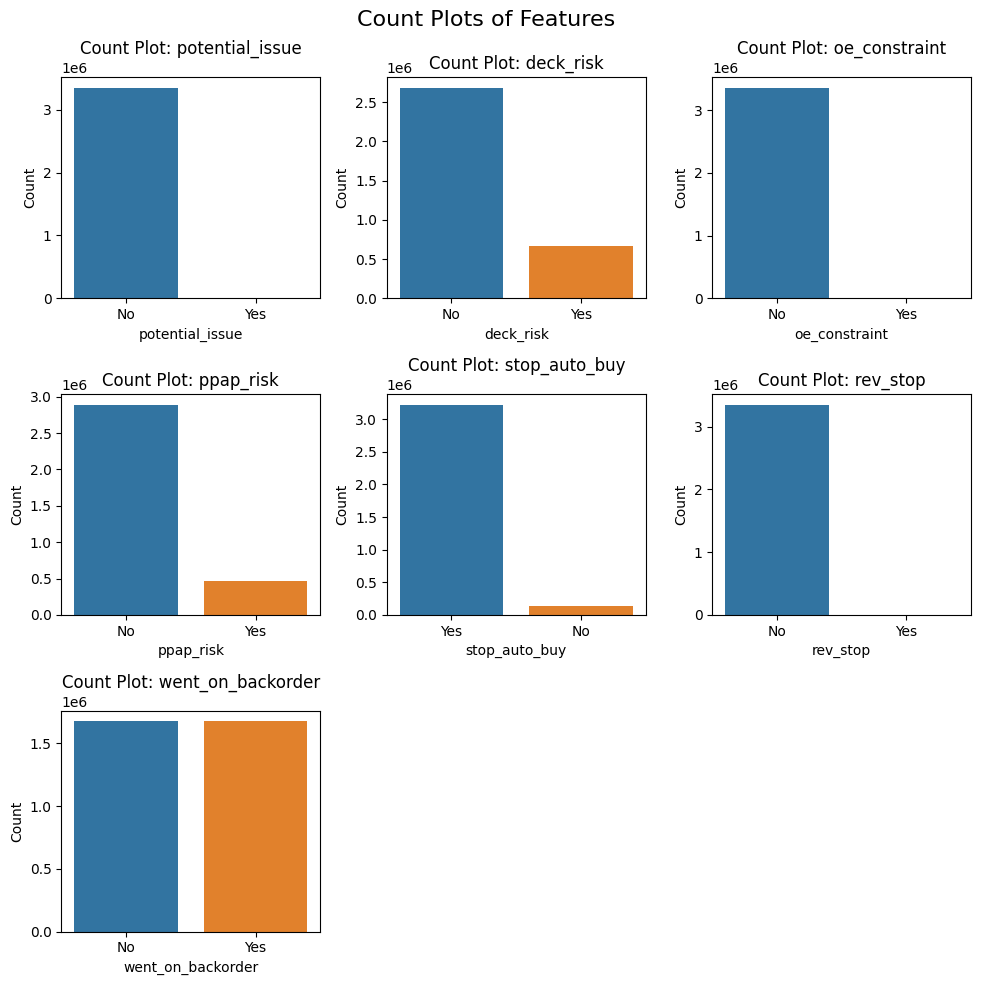

In [ ]:
plot_univariate_analysis(data=data, feature_cols=cat_cols, plot_type='count', target=None, box_cox=False, figsize=(10, 10))

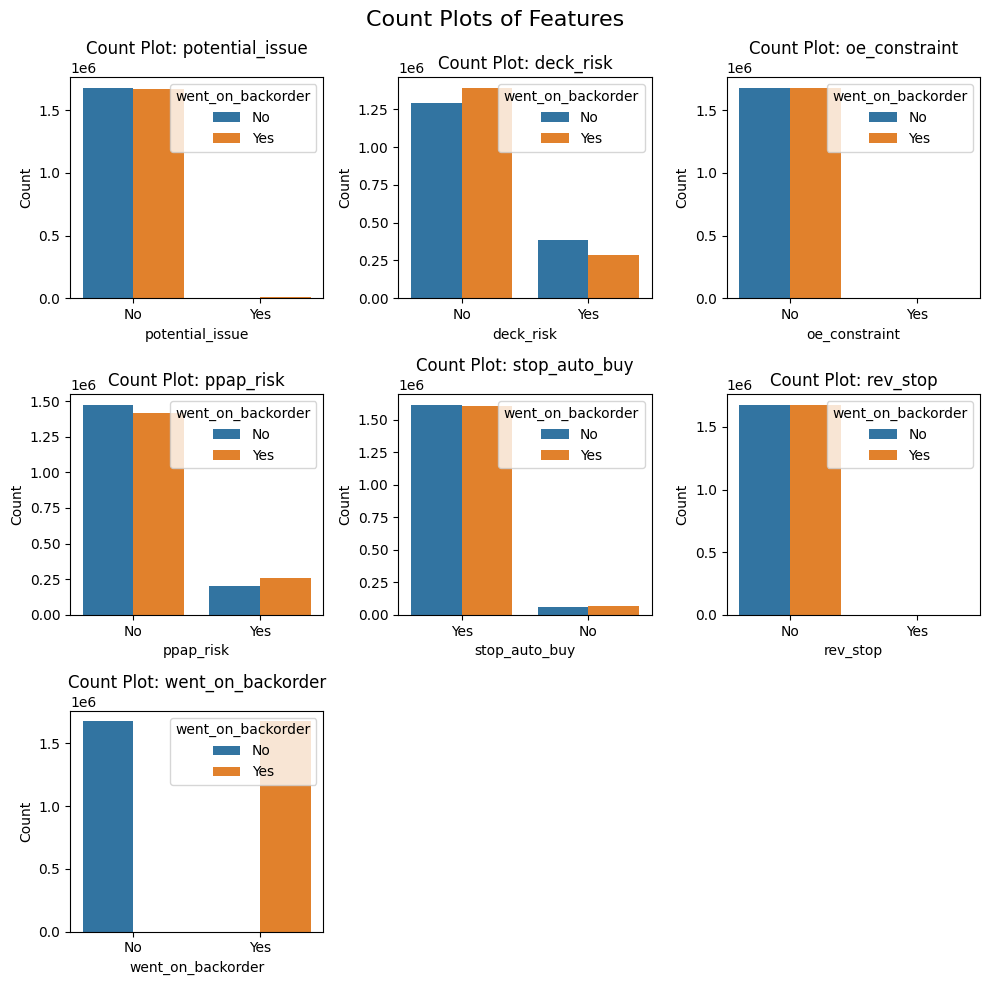

In [ ]:
plot_univariate_analysis(data=data, feature_cols=cat_cols, plot_type='count', target=None, hue='went_on_backorder',box_cox=False, figsize=(10, 10))

* After upscaling 'potential_issue', 'oe_constriant, 'rev_stop' showing no discriminating behaviour so it will be dropped and checked
* Other categoirical feature is showing good dicriminating behaviour

### EDA on balanced data set using smote

In [ ]:
data.columns

Index(['national_inv', 'lead_time', 'in_transit_qty', 'forecast_3_month',
       'forecast_6_month', 'forecast_9_month', 'sales_1_month',
       'sales_3_month', 'sales_6_month', 'sales_9_month', 'min_bank',
       'potential_issue', 'pieces_past_due', 'perf_6_month_avg',
       'perf_12_month_avg', 'local_bo_qty', 'deck_risk', 'oe_constraint',
       'ppap_risk', 'stop_auto_buy', 'rev_stop', 'went_on_backorder'],
      dtype='object')

In [ ]:
cat_cols

Index(['potential_issue', 'deck_risk', 'oe_constraint', 'ppap_risk',
       'stop_auto_buy', 'rev_stop', 'went_on_backorder'],
      dtype='object')

In [ ]:
from imblearn.over_sampling import SMOTENC

# Identify the indices of categorical columns in the dataset
categorical_indices = [data.columns.get_loc(col) for col in cat_cols]

X,_ = SMOTENC(categorical_features=categorical_indices ).fit_resample(data.dropna(),data.dropna().iloc[:,-1])
print(X.shape)
print(_.shape)

(3151996, 22)
(3151996,)


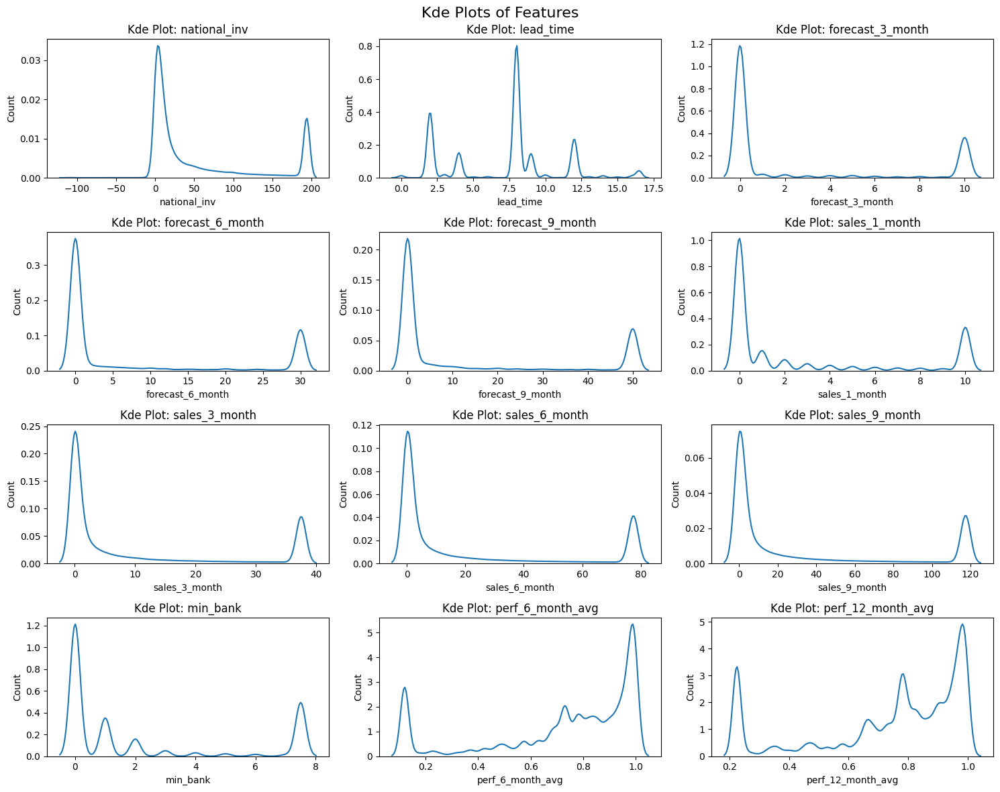

In [ ]:
# plotting after dealing with outlier and removing extreme sparse feature
plot_univariate_analysis(data=data, feature_cols=numeric_cols, plot_type='kde', target=None, hue=None,box_cox=False, figsize=(15,12))

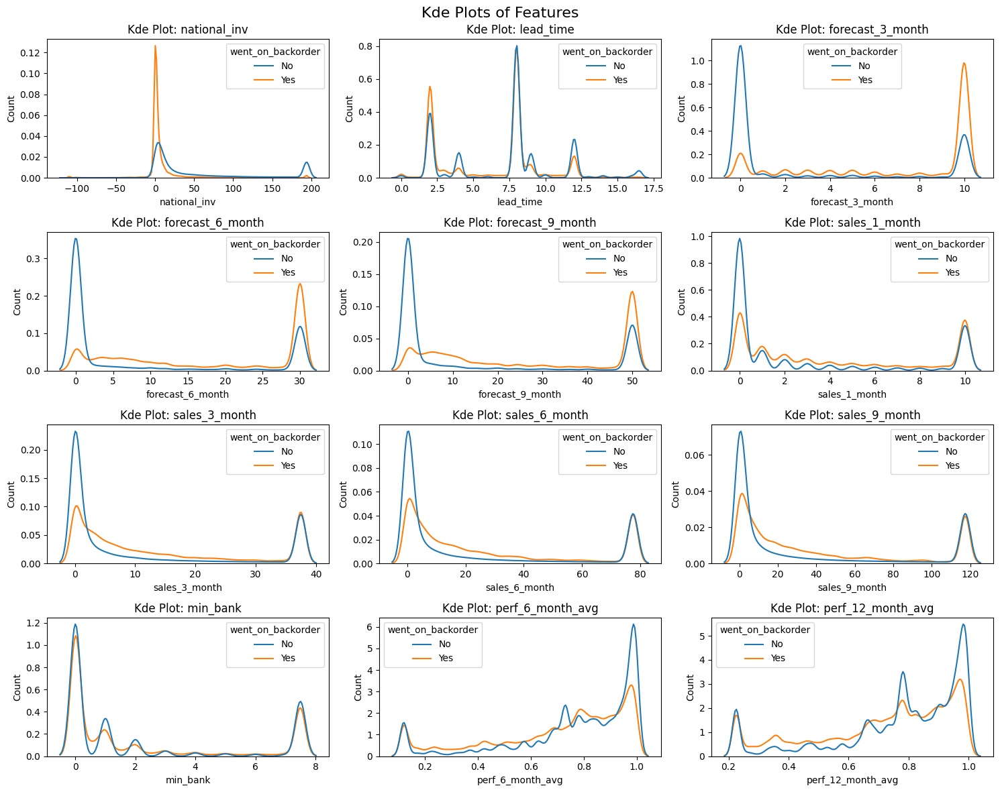

In [ ]:
plot_univariate_analysis(data=X, feature_cols=numeric_cols, plot_type='kde', target=None, hue='went_on_backorder',box_cox=False, figsize=(15,12))

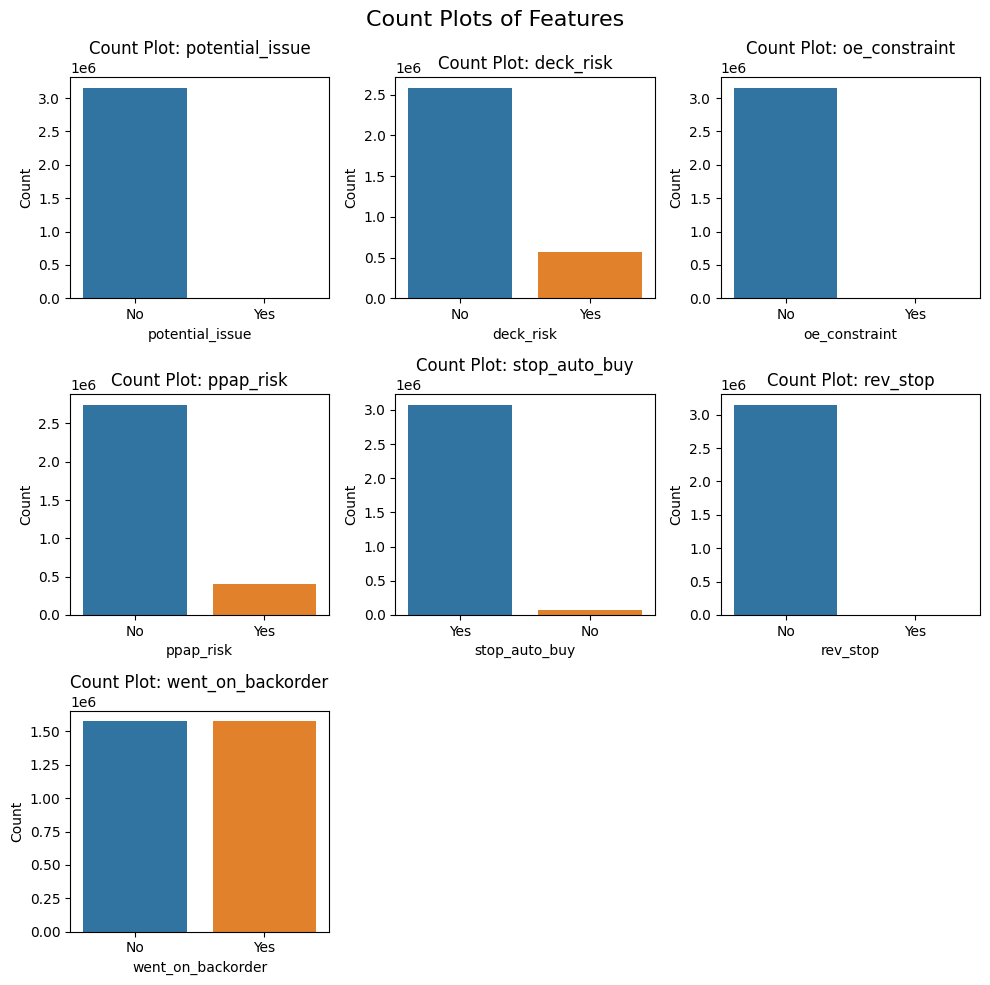

In [ ]:
plot_univariate_analysis(data=X, feature_cols=cat_cols, plot_type='count', target=None, box_cox=False, figsize=(10, 10))

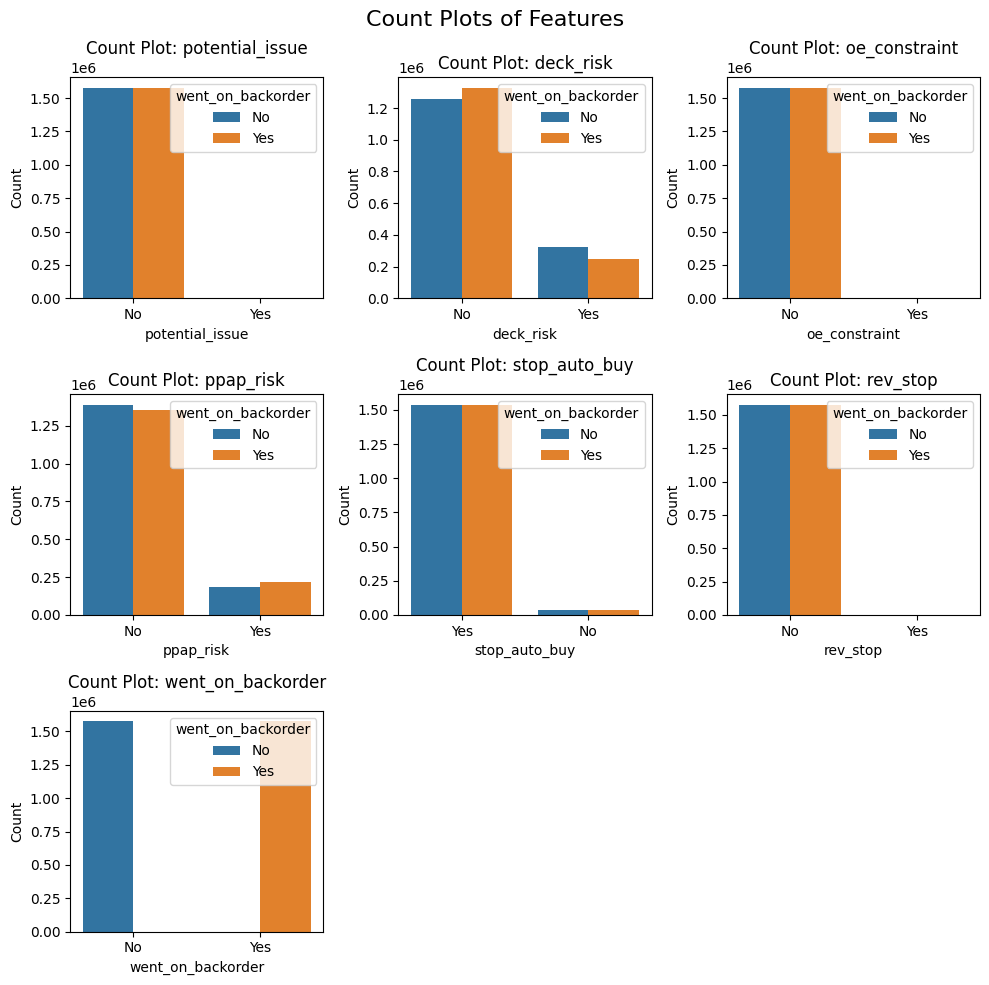

In [ ]:
plot_univariate_analysis(data=X, feature_cols=cat_cols, plot_type='count', target=None, hue='went_on_backorder',box_cox=False, figsize=(10, 10))

* Results are very similar to Random oversampling

## Approcah for next data transformation

There are lot of options availble for preprocessing data all these options are hyperparameters and can be cross validated to find the best preprocessing pipelin

### Fixed steps which will done initially before any data transformation
* dropping unncessary features  `'sku'`

### Diffrent pre-processing optiona availbale

1. use all the data as it is without any modification
2. Use winsorization to handle outlier
3. removing extreme sparse feature  ['in_transit_qty', 'local_bo_qty', 'pieces_past_due']
4. Removing extreme imbalance features ['potential_issue', 'oe_constraint', and 'rev_stop]
5. Removing extreme sparse features

### Options for Handling categorical feature
1. Use one hot encode by removing first dummy variable
2.Keeping all the variabbles

### Options for imputation

 * `lead_time` has 100894 missing records (6%) which is large so these records cant be dropped
 * For rest of the features there is onlu one missing records so these will be dropped
 * For handiling the missing value of lead_time knn_imputer and median imputaion will be used
 * add_indicator will be explored

### Refrences

 * https://chinmaydalvi.medium.com/backorder-prediction-using-machine-learning-cbe2a7d2cfa4
